# Customer Segmentation : RFM Clustering

# ABSTRACT
In this project segment the customers of an e-commerce company by using the RFM approach. This will enable
the e-commerce company to optimize their retention and
acquisition strategies.

# About the project

We have the dataset with customer details,product id, invoiceNO, price price per unit etc. and we need to divide people on clusters so that we can make customised strategies for each person. we will follow the RFM model for dividing customers into clusters.


In [126]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
import datetime as dt
%matplotlib inline
import statsmodels.api as sm
import statsmodels.formula.api as smf
import missingno as msno
import plotly.express as px
import plotly.graph_objects as go
import datetime
from sklearn.compose import make_column_transformer
import matplotlib
import warnings
warnings.filterwarnings('ignore')

# Import plotly and cufflinks in offline mode
import cufflinks as cf 
import plotly.offline as pyoff
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)
import plotly.graph_objects as go

import colorama
from colorama import Fore, Style
from termcolor import colored
from termcolor import cprint

import ipywidgets
from ipywidgets import interact 

import pandas_profiling
from pandas_profiling.report.presentation.flavours.html.templates import create_html_assets

from wordcloud import wordcloud

import squarify as sq

# Figure&Display options
plt.rcParams["figure.figsize"] = (16, 9)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.2f' % x)



In [127]:
data = pd.read_csv("D:\Data science PDF\Internship\E commerce\E-com_Data.csv")

# Data and problem Detail
Organization has asked to draw meaningful insights from 2 years of data and provide
provide brief details based on the monetry value, frequency of buy etc.

# Objective:
Build an unsupervised learning model which can enable your 
company to analyse their customers vis RFM(Recency, Frequency and 
Monetary Value Approach)

In [128]:
# Read the data
data.head()

,CustomerID,Item Code,InvoieNo,Date of purchase,Quantity,Time,price per Unit,Price,Shipping Location,Cancelled_status,Reason of return,Sold as set
0,4355.00,15734,398177,10/29/2017,6,03:36:00 PM,321.00,1926.00,Location 1,NaN,NaN,NaN
1,4352.00,14616,394422,10/05/2017,2,02:53:00 PM,870.00,1740.00,Location 1,NaN,NaN,NaN
2,4352.00,14614,394422,10/12/2017,2,02:53:00 PM,933.00,1866.00,Location 1,NaN,NaN,NaN
3,4352.00,85014B,388633,08/22/2017,3,02:47:00 PM,623.00,1869.00,Location 1,NaN,NaN,NaN
4,4352.00,15364,394422,10/10/2017,2,02:53:00 PM,944.00,1888.00,Location 1,NaN,NaN,NaN


# Explore the data

In [129]:
# Row AND column in data
data.shape
print('Rows: ',data.shape[0])
print('columns: ',data.shape[1])

Rows:  537979
columns:  12


In [130]:
cprint('Information about Data type, AND memory usuage :','blue')
data.info()

Information about Data type, AND memory usuage :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 537979 entries, 0 to 537978
Data columns (total 12 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   CustomerID         404189 non-null  float64
 1   Item Code          537979 non-null  object 
 2   InvoieNo           537979 non-null  int64  
 3   Date of purchase   537979 non-null  object 
 4   Quantity           537979 non-null  int64  
 5   Time               537979 non-null  object 
 6   price per Unit     537979 non-null  float64
 7   Price              537979 non-null  float64
 8   Shipping Location  537979 non-null  object 
 9   Cancelled_status   8345 non-null    float64
 10  Reason of return   3 non-null       object 
 11  Sold as set        0 non-null       float64
dtypes: float64(5), int64(2), object(5)
memory usage: 49.3+ MB


In [131]:
cprint('Describe the INT and FLOAT columns :','blue')
data.describe().T

Describe the INT and FLOAT columns :


,count,mean,std,min,25%,50%,75%,max
CustomerID,404189.00,2181.91,1252.68,2.00,1207.00,2078.00,3291.00,4372.00
InvoieNo,537979.00,385017.57,13426.05,361429.00,372961.00,385706.00,396873.00,406651.00
Quantity,537979.00,9.34,27.62,-2003.00,1.00,3.00,10.00,3186.00
price per Unit,537979.00,378.34,440.05,1.00,169.00,261.00,456.00,64973.00
Price,537979.00,2161.41,4538.49,-10152.00,451.00,1194.00,2232.00,90400.00
Cancelled_status,8345.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00
Sold as set,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [132]:
cprint('Describe the OBJECTS columns :','blue')
data.describe(include=object).T

Describe the OBJECTS columns :


,count,unique,top,freq
Item Code,537979,4009,85123A,2298
Date of purchase,537979,381,11/18/2017,3195
Time,537979,770,03:56:00 PM,2616
Shipping Location,537979,20,Location 36,501963
Reason of return,3,2,Missing,2


In [133]:
data['Cancelled_status']=np.where((data['Quantity']<0),'1',data['Cancelled_status'])

In [134]:
data['Cancelled_status'].value_counts() 

nan    528476
1        9503
Name: Cancelled_status, dtype: int64

In [135]:
data['Cancelled_status'] = data['Cancelled_status'].replace ({'nan':0, 1:1})

In [136]:
data['Cancelled_status'].value_counts()

0    528476
1      9503
Name: Cancelled_status, dtype: int64

In [137]:
## NOW the CANCELLED data has "NO NULL" values

data['Cancelled_status'].isnull().sum()

0

In [138]:
data['Reason of return']=np.where(data['Quantity']<=0,'unsatisfied',data['Reason of return'])

In [139]:
data['Reason of return']=np.where(data['Quantity']>0,'satisfied',data['Reason of return'])

In [140]:
data.head()

,CustomerID,Item Code,InvoieNo,Date of purchase,Quantity,Time,price per Unit,Price,Shipping Location,Cancelled_status,Reason of return,Sold as set
0,4355.00,15734,398177,10/29/2017,6,03:36:00 PM,321.00,1926.00,Location 1,0,satisfied,NaN
1,4352.00,14616,394422,10/05/2017,2,02:53:00 PM,870.00,1740.00,Location 1,0,satisfied,NaN
2,4352.00,14614,394422,10/12/2017,2,02:53:00 PM,933.00,1866.00,Location 1,0,satisfied,NaN
3,4352.00,85014B,388633,08/22/2017,3,02:47:00 PM,623.00,1869.00,Location 1,0,satisfied,NaN
4,4352.00,15364,394422,10/10/2017,2,02:53:00 PM,944.00,1888.00,Location 1,0,satisfied,NaN


In [141]:
data1=data.drop(columns=['Sold as set'],axis=1)

In [142]:
cprint('SO we have now 11 columns :','blue')
data1.head(1)

SO we have now 11 columns :


,CustomerID,Item Code,InvoieNo,Date of purchase,Quantity,Time,price per Unit,Price,Shipping Location,Cancelled_status,Reason of return
0,4355.00,15734,398177,10/29/2017,6,03:36:00 PM,321.00,1926.00,Location 1,0,satisfied


In [143]:
cprint('IN INDEX we have :','blue')
data1.columns

IN INDEX we have :


Index(['CustomerID', 'Item Code', 'InvoieNo', 'Date of purchase', 'Quantity',
       'Time', 'price per Unit', 'Price', 'Shipping Location',
       'Cancelled_status', 'Reason of return'],
      dtype='object')

In [144]:
data1.rename(columns={'CustomerID':'customer_id','Item Code':'item_code','InvoieNo':'invoice_no',
                     'Date of purchase':'date_of_purchase','Quantity':'quantity','Time':'time',
                     'price per Unit':'price_per_unit','Price':'price','Shipping Location':'shipping_location',
                     'Cancelled_status':'cancelled_status','Reason of return':'reason_of_return'},inplace=True)
data1.head(1)

,customer_id,item_code,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
0,4355.00,15734,398177,10/29/2017,6,03:36:00 PM,321.00,1926.00,Location 1,0,satisfied


In [145]:
## only customer_id is left with null values
cprint(' Number of NULL values :','blue')
data1.isnull().sum()

 Number of NULL values :


customer_id          133790
item_code                 0
invoice_no                0
date_of_purchase          0
quantity                  0
time                      0
price_per_unit            0
price                     0
shipping_location         0
cancelled_status          0
reason_of_return          0
dtype: int64

In [146]:
cprint('The unique counts in the column DATASET :','blue')

dict= {}
for x in list(data1.columns):
    dict[x] = data1[x].value_counts().shape[0]
pd.DataFrame(dict, index=['Unique Counts']).transpose()

The unique counts in the column DATASET :


,Unique Counts
customer_id,4349
item_code,4009
invoice_no,24928
date_of_purchase,381
quantity,462
time,770
price_per_unit,2900
price,13529
shipping_location,20
cancelled_status,2


In [147]:
cat_cols = data1.select_dtypes(include='object').columns

In [148]:
cprint('The categorical columns in the dataset :','blue')
cat_cols

The categorical columns in the dataset :


Index(['item_code', 'date_of_purchase', 'time', 'shipping_location',
       'cancelled_status', 'reason_of_return'],
      dtype='object')

In [149]:
Num_cols = data1.select_dtypes(include='float64').columns

In [150]:
cprint('The Numerical columns in the dataset :','blue')
Num_cols

The Numerical columns in the dataset :


Index(['customer_id', 'price_per_unit', 'price'], dtype='object')

In [151]:
## IN the data set some values are negative(as a cancelled order). IN the some part of data analysis 
## we don't need cancelled_status(because it has negative value).
## some part of data only need postive value, SO we separte data negative as well positive value 

data2=data1.loc[~(data1['quantity'] < 0)]

In [152]:
data1.shape

(537979, 11)

In [153]:
data2.shape

(528476, 11)

## Explore the DATASET columnwise

In [154]:
data1['shipping_location'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: shipping_location
Non-Null Count   Dtype 
--------------   ----- 
537979 non-null  object
dtypes: object(1)
memory usage: 4.1+ MB


In [155]:
data1['shipping_location'].describe().T

count          537979
unique             20
top       Location 36
freq           501963
Name: shipping_location, dtype: object

The Number of observations in the shipping location


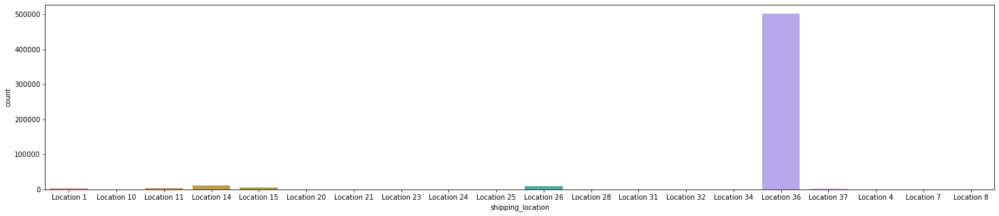

In [156]:
cprint("The Number of observations in the shipping location",'blue')
plt.figure(figsize=(25,5))
sns.countplot(data1['shipping_location'])
plt.show()

In [157]:
fig = px.histogram(data1,x='shipping_location',
                  title = 'The Number of Counts by location').update_xaxes(categoryorder='total descending')
fig.show()

# Invoice_no

In [158]:
data1['invoice_no'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: invoice_no
Non-Null Count   Dtype
--------------   -----
537979 non-null  int64
dtypes: int64(1)
memory usage: 4.1 MB


In [159]:
data1['invoice_no'].describe().T

count   537979.00
mean    385017.57
std      13426.05
min     361429.00
25%     372961.00
50%     385706.00
75%     396873.00
max     406651.00
Name: invoice_no, dtype: float64

In [161]:
cprint('Total number of invoices by customer_ID :','blue')
data1.groupby('customer_id')['invoice_no'].count().sort_values(ascending=False)

Total number of invoices by customer_ID :


customer_id
4043.00    7971
1896.00    5874
1301.00    5099
331.00     4615
1675.00    2779
           ... 
593.00        1
1485.00       1
3992.00       1
3407.00       1
4242.00       1
Name: invoice_no, Length: 4349, dtype: int64

In [162]:
fig = px.histogram(data1, 
                   x = data1.groupby('shipping_location')['invoice_no'].nunique().index,
                   y = data1.groupby('shipping_location')['invoice_no'].nunique().values, 
                   title = 'The Unique Number of Invoices by Shipping location', 
                   labels = {'x' :"shipping_locationa", 'y' :"invoice_no"}).update_xaxes(categoryorder="total descending")
fig.show();

In [163]:
cprint("The Top five 'invoice_no' by 'total_price':", 'blue' )
data1.groupby(['invoice_no','customer_id','shipping_location'])['price'].sum().sort_values(ascending=False).head()

The Top five 'invoice_no' by 'total_price':


invoice_no  customer_id  shipping_location
381981      56.00        Location 36         2586879.00
397099      1704.00      Location 36         2329980.00
388140      1704.00      Location 36         2284618.00
388678      56.00        Location 36         2161520.00
377947      1704.00      Location 36         1751064.00
Name: price, dtype: float64

In [164]:
cprint("The Bottom Five 'invoice_no' by 'price':",'blue')
data2.groupby(['invoice_no','customer_id','shipping_location'])['price'].sum().sort_values().head()

The Bottom Five 'invoice_no' by 'price':


invoice_no  customer_id  shipping_location
404209      1670.00      Location 20         30.00
406533      1675.00      Location 26         32.00
397577      3237.00      Location 11         43.00
396373      1000.00      Location 11         44.00
394747      2669.00      Location 26         44.00
Name: price, dtype: float64

In [165]:
cprint("The Top Five 'invoice_no'By quantity:", 'blue')
data1.groupby(['invoice_no','customer_id','shipping_location'])['quantity'].sum().sort_values(ascending=False).head()

The Top Five 'invoice_no'By quantity:


invoice_no  customer_id  shipping_location
388140      1704.00      Location 36          13126
381981      56.00        Location 36          12937
397099      1704.00      Location 36          11148
377947      1704.00      Location 36          10758
388678      56.00        Location 36           9776
Name: quantity, dtype: int64

# Quantity

In [166]:
data1['quantity'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: quantity
Non-Null Count   Dtype
--------------   -----
537979 non-null  int64
dtypes: int64(1)
memory usage: 4.1 MB


In [167]:
data1['quantity'].describe().T

count   537979.00
mean         9.34
std         27.62
min      -2003.00
25%          1.00
50%          3.00
75%         10.00
max       3186.00
Name: quantity, dtype: float64

In [168]:
cprint("The Number of observations in the 'Quantity column which are Below 0",'blue')
data1[data1['quantity']<0]

The Number of observations in the 'Quantity column which are Below 0


,customer_id,item_code,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
6,4343.00,15364,368432,02/13/2017,-4,02:46:00 PM,922.00,-3688.00,Location 1,1,unsatisfied
31,4325.00,14619,366771,01/31/2017,-1,11:07:00 AM,179.00,-179.00,Location 1,1,unsatisfied
121,4107.00,15364,364641,12/21/2016,-1,12:41:00 PM,885.00,-885.00,Location 1,1,unsatisfied
153,4043.00,85014B,387837,08/10/2017,-1,12:18:00 PM,694.00,-694.00,Location 1,1,unsatisfied
252,3951.00,14614,384727,07/20/2017,-1,01:33:00 PM,943.00,-943.00,Location 1,1,unsatisfied
...,...,...,...,...,...,...,...,...,...,...,...
537866,3309.00,85194L,372168,03/31/2017,-8,11:02:00 AM,122.00,-976.00,Location 8,1,unsatisfied
537867,3309.00,85194L,372305,03/28/2017,-8,04:34:00 PM,106.00,-848.00,Location 8,1,unsatisfied
537898,1633.00,14693,393042,09/24/2017,-2,10:40:00 AM,394.00,-788.00,Location 8,1,unsatisfied
537900,1631.00,14693,380693,06/08/2017,-4,12:04:00 PM,415.00,-1660.00,Location 8,1,unsatisfied


In [169]:
## Total number of quantities above 0 and below 0
(data1['quantity']<0).value_counts()

False    528476
True       9503
Name: quantity, dtype: int64

In [170]:
quantity_values = (data1['quantity'] < 0).value_counts()
quantity_values = pd.DataFrame(quantity_values)
quantity_values.rename(index={False: 'Invoices Bigger Than 0', True: 'Invoices smaller Than 0'}, inplace=True)
quantity_values

,quantity
Invoices Bigger Than 0,528476
Invoices smaller Than 0,9503


In [171]:
fig = px.pie(quantity_values, 
             values = quantity_values['quantity'], 
             names = quantity_values.index, 
             title = 'Quantity Smaller/Bigger')

fig.show()

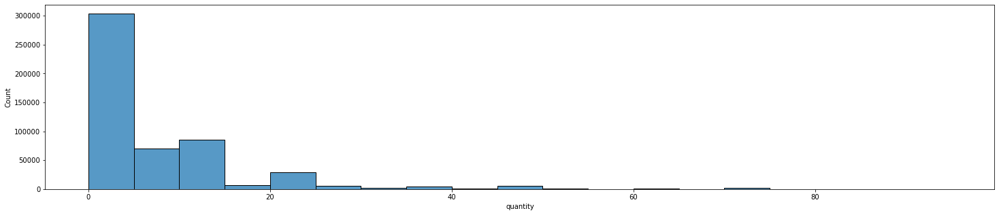

In [172]:
plt.figure(figsize=(25,5))
sns.histplot(data1['quantity'],bins=range(0,100,5))
plt.show()

# CANCELLED_STATUS

In [173]:
data1['cancelled_status'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: cancelled_status
Non-Null Count   Dtype 
--------------   ----- 
537979 non-null  object
dtypes: object(1)
memory usage: 4.1+ MB


In [174]:
data1['cancelled_status'].describe().T

count     537979
unique         2
top            0
freq      528476
Name: cancelled_status, dtype: int64

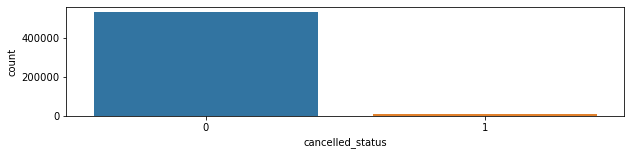

In [175]:
plt.figure(figsize=(10,2))
sns.countplot(data1['cancelled_status'])
plt.show()

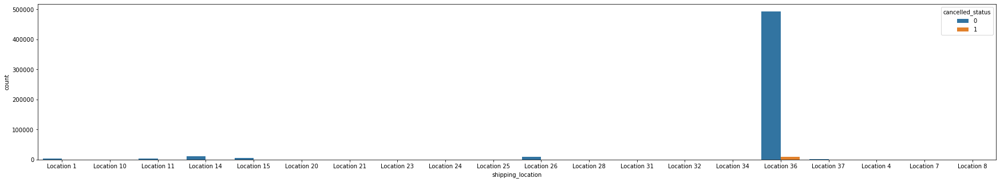

In [176]:
plt.figure(figsize=(30,5))
sns.countplot(data1['shipping_location'],hue=data1['cancelled_status'])
plt.show()

# PRICE_PER_UNIT

In [177]:
data1['price_per_unit'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: price_per_unit
Non-Null Count   Dtype  
--------------   -----  
537979 non-null  float64
dtypes: float64(1)
memory usage: 4.1 MB


In [178]:
data1['price_per_unit'].describe().T

count   537979.00
mean       378.34
std        440.05
min          1.00
25%        169.00
50%        261.00
75%        456.00
max      64973.00
Name: price_per_unit, dtype: float64

In [179]:
cprint("The Number of obervations in the 'price_per_unit' less than 0", 'blue')
price_per_unit_value = (data1['price_per_unit'] ==0).value_counts()
price_per_unit_value = pd.DataFrame(price_per_unit_value)
price_per_unit_value

The Number of obervations in the 'price_per_unit' less than 0


,price_per_unit
False,537979


In [180]:
cprint("The Number of obervations in the 'price_per_unit' greater than 0", 'blue')
price_per_unit_value = (data1['price_per_unit'] > 0).value_counts()
price_per_unit_value = pd.DataFrame(price_per_unit_value)
price_per_unit_value

The Number of obervations in the 'price_per_unit' greater than 0


,price_per_unit
True,537979


# Customer_id

In [181]:
data1['customer_id'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: customer_id
Non-Null Count   Dtype  
--------------   -----  
404189 non-null  float64
dtypes: float64(1)
memory usage: 4.1 MB


In [182]:
data1['customer_id'].describe().T

count   404189.00
mean      2181.91
std       1252.68
min          2.00
25%       1207.00
50%       2078.00
75%       3291.00
max       4372.00
Name: customer_id, dtype: float64

In [183]:
cprint('Customer Number by orders(Top 5 )','blue')
data1.groupby(['customer_id','shipping_location'])['invoice_no'].count().sort_values(ascending=False).head()

Customer Number by orders(Top 5 )


customer_id  shipping_location
4043.00      Location 36          7383
1896.00      Location 36          5400
1301.00      Location 36          4744
331.00       Location 36          4328
1675.00      Location 36          2630
Name: invoice_no, dtype: int64

In [184]:
cprint('customer Number by order(Bottom 5)', 'blue')
data1.groupby(['customer_id','shipping_location'])['invoice_no'].count().sort_values().head()

customer Number by order(Bottom 5)


customer_id  shipping_location
3602.00      Location 14          1
1098.00      Location 14          1
3766.00      Location 25          1
1097.00      Location 25          1
2074.00      Location 11          1
Name: invoice_no, dtype: int64

In [185]:
cprint('customers status According to the Number of items in the orders (Top 5)','blue')
data1.groupby(['customer_id','shipping_location'])['quantity'].count().sort_values(ascending=False).head()

customers status According to the Number of items in the orders (Top 5)


customer_id  shipping_location
4043.00      Location 36          7383
1896.00      Location 36          5400
1301.00      Location 36          4744
331.00       Location 36          4328
1675.00      Location 36          2630
Name: quantity, dtype: int64

In [186]:
cprint('customers status According to the Number of items in the orders (Bottom 5)','blue')
data1.groupby(['customer_id','shipping_location'])['quantity'].count().sort_values().head()

customers status According to the Number of items in the orders (Bottom 5)


customer_id  shipping_location
3602.00      Location 14          1
1098.00      Location 14          1
3766.00      Location 25          1
1097.00      Location 25          1
2074.00      Location 11          1
Name: quantity, dtype: int64

In [187]:
(data1['quantity']==1).value_counts()

False    391065
True     146914
Name: quantity, dtype: int64

In [188]:
fig = px.histogram(data1, 
                   x = data1.groupby('shipping_location')['customer_id'].nunique().index,
                   y = data1.groupby('shipping_location')['customer_id'].nunique().values, 
                   title = 'The Unique Number of customers by shipping_location', 
                   labels = {'x' :"shipping_locationa", 'y' :"customer_id"}).update_xaxes(categoryorder="total descending")
fig.show();

# ITEM_CODE

In [189]:
data1['item_code'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: item_code
Non-Null Count   Dtype 
--------------   ----- 
537979 non-null  object
dtypes: object(1)
memory usage: 4.1+ MB


In [190]:
data1['item_code'].describe(include=object)

count     537979
unique      4009
top       85123A
freq        2298
Name: item_code, dtype: object

In [191]:
data1['item_code'].unique()

array(['15734', '14616', '14614', ..., '85194L', '14693', '77618'],
      dtype=object)

In [192]:
list_special_codes = data1[data1['item_code'].str.contains('[a-zA-Z]+', regex=True)]['item_code'].unique()
list_special_codes

array(['85014B', '85014A', '35004G', ..., '84611B', '46000U', '85194L'],
      dtype=object)

In [193]:
list_special_codes = data1[data1['item_code'].str.contains('[a-zA-Z]+', regex=True)]['item_code'].value_counts()
list_special_codes

85123A    2298
85099B    2145
85099C     957
82494L     937
85099F     836
          ... 
85226A       1
84971L       1
72803B       1
35600A       1
84967B       1
Name: item_code, Length: 1066, dtype: int64

In [194]:
fig = px.histogram(data1, 
                   x = data1.groupby('shipping_location')['item_code'].nunique().index,
                   y = data1.groupby('shipping_location')['item_code'].nunique().values, 
                   title = 'The Unique Number of customers by item_code', 
                   labels = {'x' :"shipping_locationa", 'y' :"item_code"}).update_xaxes(categoryorder="total descending")
fig.show();

In [195]:
cprint('item status According to the Spendings (Top 5)','blue')
data1.groupby(['item_code'])['price'].sum().sort_values(ascending=False).head()

item status According to the Spendings (Top 5)


item_code
14846    15152978.00
85099B   10786684.00
39989    10188997.00
85123A    9309871.00
77302     6731473.00
Name: price, dtype: float64

In [196]:
cprint('item status According to the Spendings (Bottom 5)','blue')
data2.groupby(['item_code'])['price'].sum().sort_values().head()

item status According to the Spendings (Bottom 5)


item_code
90042B    9.00
77467    25.00
13272    26.00
84247C   32.00
85226A   50.00
Name: price, dtype: float64

In [197]:
cprint('item status According to the customer_id (Top 5)','blue')
data1.groupby(['item_code'])['customer_id'].count().sort_values(ascending=False).head()

item status According to the customer_id (Top 5)


item_code
85123A    2064
14846     1867
85099B    1649
77302     1415
39989     1413
Name: customer_id, dtype: int64

# PRICE

In [198]:
data1['price'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: price
Non-Null Count   Dtype  
--------------   -----  
537979 non-null  float64
dtypes: float64(1)
memory usage: 4.1 MB


In [199]:
data1['price'].describe().T

count   537979.00
mean      2161.41
std       4538.49
min     -10152.00
25%        451.00
50%       1194.00
75%       2232.00
max      90400.00
Name: price, dtype: float64

# REASON_OF _RETURN

In [200]:
data1['reason_of_return'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: reason_of_return
Non-Null Count   Dtype 
--------------   ----- 
537979 non-null  object
dtypes: object(1)
memory usage: 4.1+ MB


In [201]:
data1['reason_of_return'].describe()

count        537979
unique            2
top       satisfied
freq         528476
Name: reason_of_return, dtype: object

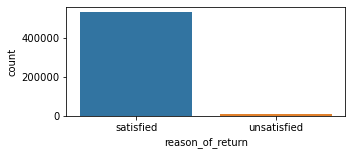

In [202]:
plt.figure(figsize=(5,2))
sns.countplot(data1['reason_of_return'])
plt.show()

In [203]:
data1[data1['reason_of_return']=='satisfied'].count()

customer_id          396006
item_code            528476
invoice_no           528476
date_of_purchase     528476
quantity             528476
time                 528476
price_per_unit       528476
price                528476
shipping_location    528476
cancelled_status     528476
reason_of_return     528476
dtype: int64

In [204]:
data1[data1['reason_of_return']=='unsatisfied'].count()

customer_id          8183
item_code            9503
invoice_no           9503
date_of_purchase     9503
quantity             9503
time                 9503
price_per_unit       9503
price                9503
shipping_location    9503
cancelled_status     9503
reason_of_return     9503
dtype: int64

# Invoice Data

In [205]:
data1['date_of_purchase'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 537979 entries, 0 to 537978
Series name: date_of_purchase
Non-Null Count   Dtype 
--------------   ----- 
537979 non-null  object
dtypes: object(1)
memory usage: 4.1+ MB


In [206]:
data1['date_of_purchase'].describe().T

count         537979
unique           381
top       11/18/2017
freq            3195
Name: date_of_purchase, dtype: object

In [207]:
data1['date_of_purchase']=pd.to_datetime(data1['date_of_purchase'])

In [208]:
data1['date_of_purchase'].max()

Timestamp('2017-12-19 00:00:00')

In [209]:
data1['date_of_purchase'].min()

Timestamp('2016-12-02 00:00:00')

In [210]:
data1.insert(loc=2, column='year_month', value=data1['date_of_purchase'].map(lambda x: 100*x.year + x.month))
data1.insert(loc=2, column='month', value=data1['date_of_purchase'].map(lambda x: x.month))
data1.head()

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
0,4355.00,15734,10,201710,398177,2017-10-29,6,03:36:00 PM,321.00,1926.00,Location 1,0,satisfied
1,4352.00,14616,10,201710,394422,2017-10-05,2,02:53:00 PM,870.00,1740.00,Location 1,0,satisfied
2,4352.00,14614,10,201710,394422,2017-10-12,2,02:53:00 PM,933.00,1866.00,Location 1,0,satisfied
3,4352.00,85014B,8,201708,388633,2017-08-22,3,02:47:00 PM,623.00,1869.00,Location 1,0,satisfied
4,4352.00,15364,10,201710,394422,2017-10-10,2,02:53:00 PM,944.00,1888.00,Location 1,0,satisfied


The Number of orders in month


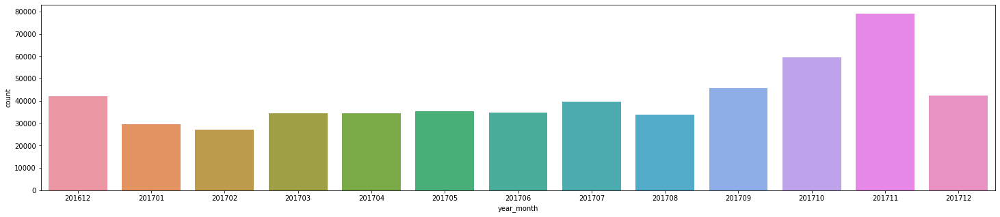

In [211]:
cprint("The Number of orders in month",'blue')
plt.figure(figsize=(25,5))
sns.countplot(data1['year_month'])
plt.show()

In [212]:
cprint('Number of orders by month:','blue')
data1['year_month'].value_counts()

Number of orders by month:


201711    79055
201710    59663
201709    45649
201712    42408
201612    41988
201707    39590
201705    35490
201706    34740
201703    34491
201704    34348
201708    33846
201701    29466
201702    27245
Name: year_month, dtype: int64

In [213]:
cprint('Revenue According to the year_month ','blue')
data1.groupby(['year_month'])['price'].sum().sort_values(ascending=False)

Revenue According to the year_month 


year_month
201711   161516356.00
201710   131128068.00
201709   104039027.10
201708    88915514.00
201612    85533760.00
201705    85344286.00
201712    81806239.00
201707    81563558.00
201706    76664499.00
201704    73955359.00
201703    73899071.00
201702    60508337.00
201701    57921587.00
Name: price, dtype: float64

In [214]:
revenu_per_month = data1.groupby(['month'])['price'].sum()
revenu_per_month

month
1     57921587.00
2     60508337.00
3     73899071.00
4     73955359.00
5     85344286.00
6     76664499.00
7     81563558.00
8     88915514.00
9    104039027.10
10   131128068.00
11   161516356.00
12   167339999.00
Name: price, dtype: float64

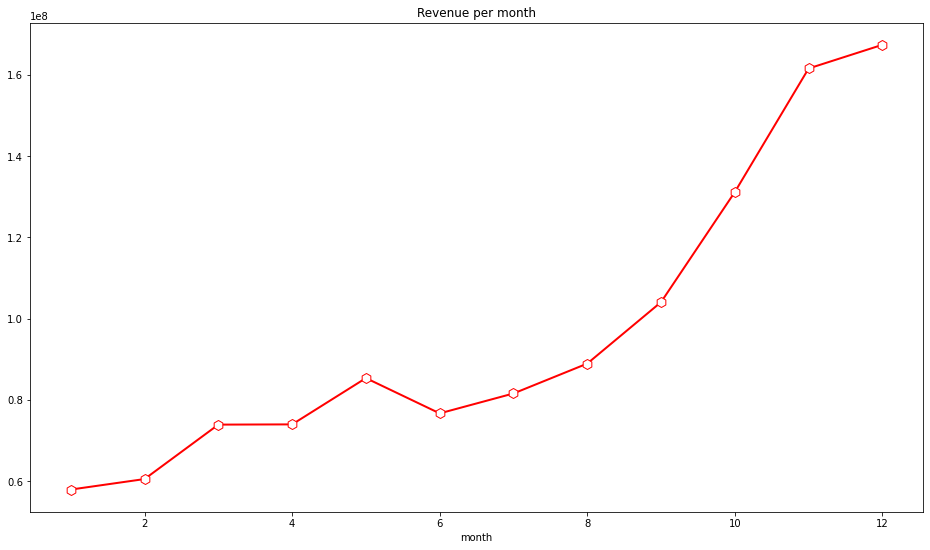

In [215]:
# Line Graph to capture the monthly revenue
revenu_per_month.plot.line(y='price', title='Revenue per month',color = 'r',
         marker='h', 
         markersize=10, linewidth=2,
         markerfacecolor='white');

In [216]:
quantity_per_month = data1.groupby(['month'])['quantity'].sum()
quantity_per_month

month
1     243349
2     262283
3     316586
4     333243
5     363303
6     337980
7     376053
8     411356
9     460977
10    587735
11    674818
12    658837
Name: quantity, dtype: int64

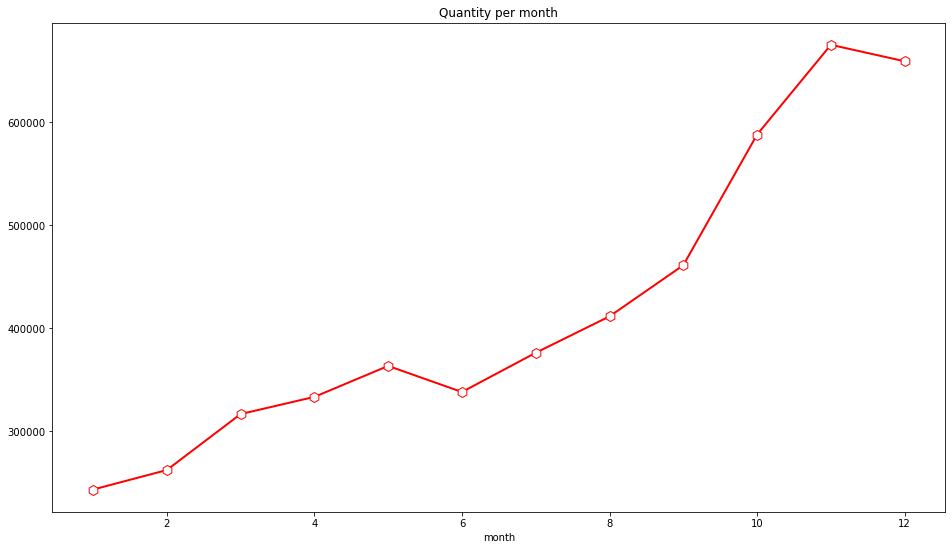

In [217]:
# Line Graph to capture the monthly qantity selling
quantity_per_month.plot.line(y='quantity', title='Quantity per month',color = 'r',
         marker='h', 
         markersize=10, linewidth=2,
         markerfacecolor='white');

# CLEAn the data(TREAT missing value and outliers)

In [218]:
data1.isnull().sum()

customer_id          133790
item_code                 0
month                     0
year_month                0
invoice_no                0
date_of_purchase          0
quantity                  0
time                      0
price_per_unit            0
price                     0
shipping_location         0
cancelled_status          0
reason_of_return          0
dtype: int64

In [219]:
((data1.isnull().sum()/data1.isnull().count())*100).sort_values(ascending=False)

customer_id         24.87
item_code            0.00
month                0.00
year_month           0.00
invoice_no           0.00
date_of_purchase     0.00
quantity             0.00
time                 0.00
price_per_unit       0.00
price                0.00
shipping_location    0.00
cancelled_status     0.00
reason_of_return     0.00
dtype: float64

In [220]:
data4=data1[data1['quantity']<0].head()
data4

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
6,4343.00,15364,2,201702,368432,2017-02-13,-4,02:46:00 PM,922.00,-3688.00,Location 1,1,unsatisfied
31,4325.00,14619,1,201701,366771,2017-01-31,-1,11:07:00 AM,179.00,-179.00,Location 1,1,unsatisfied
121,4107.00,15364,12,201612,364641,2016-12-21,-1,12:41:00 PM,885.00,-885.00,Location 1,1,unsatisfied
153,4043.00,85014B,8,201708,387837,2017-08-10,-1,12:18:00 PM,694.00,-694.00,Location 1,1,unsatisfied
252,3951.00,14614,7,201707,384727,2017-07-20,-1,01:33:00 PM,943.00,-943.00,Location 1,1,unsatisfied


In [221]:
data4=data1.loc[~(data1['quantity'] < 0)]

In [222]:
data4.shape

(528476, 13)

# Drop the duplicated values

In [223]:
data4.duplicated().value_counts()

False    528467
True          9
dtype: int64

In [224]:
data5 = data4.drop_duplicates()

In [225]:
data5.shape

(528467, 13)

In [226]:
data5.describe().T

,count,mean,std,min,25%,50%,75%,max
customer_id,395998.00,2186.42,1252.33,2.00,1212.00,2080.00,3294.00,4372.00
month,528467.00,7.72,3.51,1.00,5.00,9.00,11.00,12.00
year_month,528467.00,201699.91,25.79,201612.00,201704.00,201707.00,201710.00,201712.00
invoice_no,528467.00,385042.30,13434.19,361429.00,372970.00,385765.00,396914.00,406651.00
quantity,528467.00,9.70,27.19,1.00,1.00,3.00,10.00,3186.00
price_per_unit,528467.00,377.39,437.45,1.00,169.00,261.00,455.00,64973.00
price,528467.00,2227.08,4546.69,1.00,473.00,1244.00,2256.00,90400.00


<AxesSubplot:xlabel='price_per_unit'>

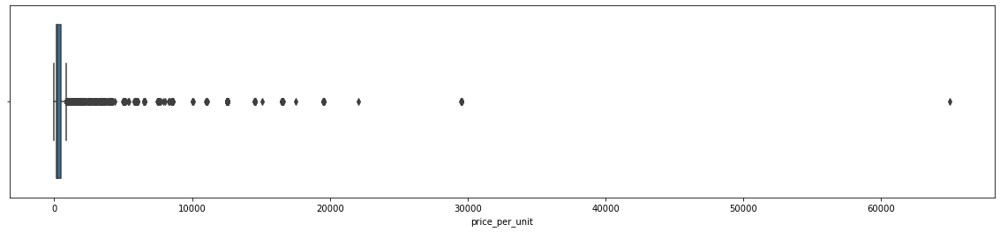

In [227]:
plt.figure(figsize=(20,4))
sns.boxplot(data5['price_per_unit'])

In [228]:
data5[data5['price_per_unit']>=60000]

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
226703,2028.00,14925,6,201706,381510,2017-06-20,1,03:33:00 PM,64973.00,64973.00,Location 36,0,satisfied


In [229]:
data5[data5['item_code']=='14925']

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
36232,4352.00,14925,2,201702,369246,2017-02-20,4,03:13:00 PM,638.00,2552.00,Location 36,0,satisfied
37442,4331.00,14925,6,201706,379643,2017-06-02,16,10:56:00 AM,532.00,8512.00,Location 36,0,satisfied
37443,4331.00,14925,5,201705,377010,2017-05-08,16,11:18:00 AM,535.00,8560.00,Location 36,0,satisfied
38488,4320.00,14925,3,201703,370582,2017-03-09,8,12:24:00 PM,613.00,4904.00,Location 36,0,satisfied
39140,4306.00,14925,4,201704,373401,2017-04-02,2,02:06:00 PM,638.00,1276.00,Location 36,0,satisfied
39219,4306.00,14925,2,201702,367991,2017-02-12,4,10:06:00 AM,669.00,2676.00,Location 36,0,satisfied
40277,4286.00,14925,4,201704,376064,2017-04-29,8,09:15:00 AM,620.00,4960.00,Location 36,0,satisfied
40283,4286.00,14925,2,201702,369781,2017-02-25,8,10:44:00 AM,658.00,5264.00,Location 36,0,satisfied
43322,4246.00,14925,12,201612,363314,2016-12-14,1,12:20:00 PM,612.00,612.00,Location 36,0,satisfied
44305,4239.00,14925,4,201704,373762,2017-04-06,1,10:55:00 AM,644.00,644.00,Location 36,0,satisfied


In [230]:
data5.drop(index=[226703],inplace=True)

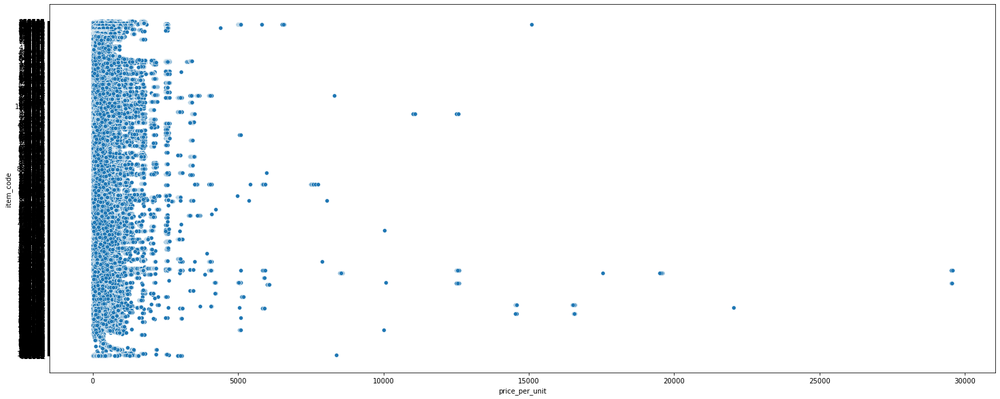

In [231]:
plt.figure(figsize=(25,10))
sns.scatterplot(x='price_per_unit',y='item_code',data=data5)
plt.show()

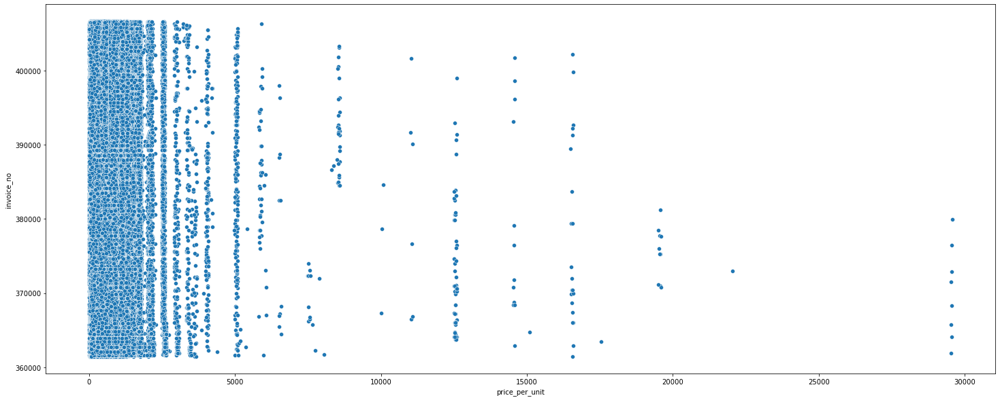

In [232]:
plt.figure(figsize=(25,10))
sns.scatterplot(x='price_per_unit',y='invoice_no',data=data5)
plt.show()

In [233]:
data5[data5['price_per_unit']>=20000]

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
92498,3725.00,15078,1,201701,365711,2017-01-16,1,02:57:00 PM,29522.00,29522.00,Location 36,0,satisfied
143014,3147.00,15078,12,201612,364144,2016-12-26,1,08:41:00 AM,29559.00,29559.00,Location 36,0,satisfied
237532,1938.00,15079,5,201705,376457,2017-05-08,1,12:22:00 PM,29541.00,29541.00,Location 36,0,satisfied
249095,1844.00,15078,2,201702,368317,2017-02-06,1,03:32:00 PM,29553.00,29553.00,Location 36,0,satisfied
342693,833.00,15079,3,201703,371544,2017-03-15,1,11:38:00 AM,29534.00,29534.00,Location 36,0,satisfied
342694,833.00,15079,3,201703,372878,2017-03-26,1,02:19:00 PM,29559.00,29559.00,Location 36,0,satisfied
358655,613.00,15078,12,201612,361899,2016-12-10,1,06:06:00 PM,29530.00,29530.00,Location 36,0,satisfied
369026,519.00,15078,5,201705,379900,2017-05-27,1,04:25:00 PM,29573.00,29573.00,Location 36,0,satisfied
536369,NaN,C2,3,201703,372965,2017-03-29,1,11:57:00 AM,22051.00,22051.00,Location 36,0,satisfied


In [234]:
data5[data5['item_code']=='15078']

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
64557,4041.00,15078,9,201709,391347,2017-09-13,1,02:34:00 PM,12591.00,12591.00,Location 36,0,satisfied
74449,3936.00,15078,6,201706,380579,2017-06-09,1,10:47:00 AM,12532.00,12532.00,Location 36,0,satisfied
74451,3936.00,15078,1,201701,366346,2017-01-26,2,12:31:00 PM,12599.00,25198.00,Location 36,0,satisfied
80695,3871.00,15078,10,201710,392932,2017-10-01,2,02:18:00 PM,12518.00,25036.00,Location 36,0,satisfied
92497,3725.00,15078,1,201701,365717,2017-01-13,2,03:07:00 PM,12545.00,25090.00,Location 36,0,satisfied
92498,3725.00,15078,1,201701,365711,2017-01-16,1,02:57:00 PM,29522.00,29522.00,Location 36,0,satisfied
105852,3584.00,15078,10,201710,397345,2017-10-30,1,11:10:00 AM,5089.00,5089.00,Location 36,0,satisfied
111548,3500.00,15078,2,201702,367186,2017-02-01,2,02:36:00 PM,12553.00,25106.00,Location 36,0,satisfied
114184,3475.00,15078,3,201703,371092,2017-03-19,2,08:33:00 AM,12576.00,25152.00,Location 36,0,satisfied
117296,3421.00,15078,11,201711,398969,2017-11-11,1,03:06:00 PM,12599.00,12599.00,Location 36,0,satisfied


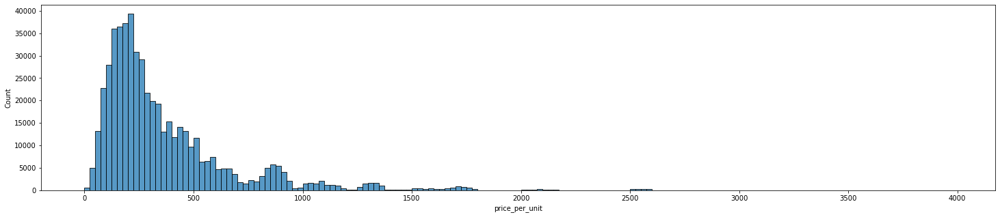

In [235]:
plt.figure(figsize=(25,5))
sns.histplot(data5['price_per_unit'],bins=range(0,4000,25))
plt.show()

<AxesSubplot:xlabel='quantity'>

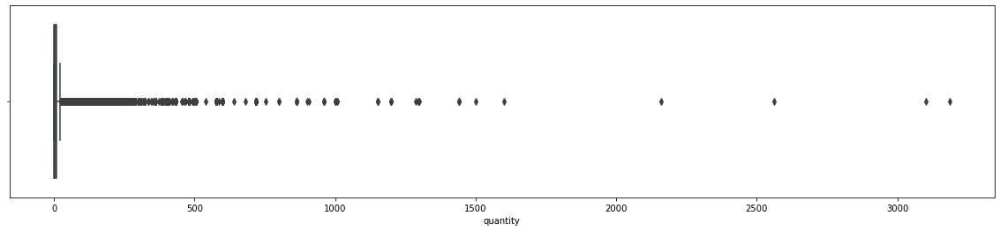

In [236]:
plt.figure(figsize=(20,4))
sns.boxplot(data5['quantity'])

In [237]:
data5[data5['quantity']>=2000]

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
30132,1305.00,14390,3,201703,372101,2017-03-22,2160,10:37:00 AM,32.00,69120.00,Location 26,0,satisfied
265928,1678.00,10430,7,201707,385663,2017-07-24,3186,05:04:00 PM,25.00,79650.00,Location 36,0,satisfied
536749,NaN,15766,7,201707,385104,2017-07-24,3100,02:28:00 PM,21.00,65100.00,Location 36,0,satisfied
536787,NaN,79063D,2,201702,367569,2017-02-01,2560,12:04:00 PM,34.00,87040.00,Location 36,0,satisfied


In [238]:
data5[data5['invoice_no']==372101]

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
11858,1305.00,15082,3,201703,372101,2017-03-26,64,10:37:00 AM,166.00,10624.00,Location 14,0,satisfied
11863,1305.00,15323,3,201703,372101,2017-03-21,100,10:37:00 AM,311.00,31100.00,Location 14,0,satisfied
30132,1305.00,14390,3,201703,372101,2017-03-22,2160,10:37:00 AM,32.00,69120.00,Location 26,0,satisfied


In [239]:
data5[data5['invoice_no']==385663]

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
265928,1678.00,10430,7,201707,385663,2017-07-24,3186,05:04:00 PM,25.00,79650.00,Location 36,0,satisfied


In [240]:
data5.drop(index=[30132,265928],inplace=True)

In [241]:
data5.isnull().sum()

customer_id          132469
item_code                 0
month                     0
year_month                0
invoice_no                0
date_of_purchase          0
quantity                  0
time                      0
price_per_unit            0
price                     0
shipping_location         0
cancelled_status          0
reason_of_return          0
dtype: int64

In [242]:
data5.dropna(axis=0, subset=['customer_id'],inplace=True)

In [243]:
data5.isnull().sum()

customer_id          0
item_code            0
month                0
year_month           0
invoice_no           0
date_of_purchase     0
quantity             0
time                 0
price_per_unit       0
price                0
shipping_location    0
cancelled_status     0
reason_of_return     0
dtype: int64

In [244]:
data5.shape

(395995, 13)

In [245]:
data5.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 395995 entries, 0 to 537949
Data columns (total 13 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   customer_id        395995 non-null  float64       
 1   item_code          395995 non-null  object        
 2   month              395995 non-null  int64         
 3   year_month         395995 non-null  int64         
 4   invoice_no         395995 non-null  int64         
 5   date_of_purchase   395995 non-null  datetime64[ns]
 6   quantity           395995 non-null  int64         
 7   time               395995 non-null  object        
 8   price_per_unit     395995 non-null  float64       
 9   price              395995 non-null  float64       
 10  shipping_location  395995 non-null  object        
 11  cancelled_status   395995 non-null  object        
 12  reason_of_return   395995 non-null  object        
dtypes: datetime64[ns](1), float64(3), int64(4), 

# FEATURE ENGINEERING

In [246]:
cprint('The unique counts in the column DATASET :','blue')

dict= {}
for x in list(data5.columns):
    dict[x] = data5[x].value_counts().shape[0]
pd.DataFrame(dict, index=['Unique Counts']).transpose()

The unique counts in the column DATASET :


,Unique Counts
customer_id,4324
item_code,3637
month,12
year_month,13
invoice_no,18303
date_of_purchase,381
quantity,207
time,737
price_per_unit,2267
price,8803


In [247]:
list_special_codes = data5[data5['shipping_location'].str.contains('[a-zA-Z]+', regex=True)]['shipping_location'].value_counts()
list_special_codes

Location 36    368827
Location 14      8124
Location 26      6827
Location 15      4148
Location 1       2859
Location 11      2215
Location 37       738
Location 25       534
Location 21       509
Location 20       391
Location 4        174
Location 23       172
Location 32       125
Location 8        105
Location 28        99
Location 10        94
Location 31        33
Location 7         17
Location 24         2
Location 34         2
Name: shipping_location, dtype: int64

In [248]:
data5['shipping_location'].replace({'Location 36':'36',
                        'Location 14':'14',
                        'Location 26':'26',
                        'Location 15':'15',
                        'Location 1':'1',
                        'Location 11':'11',
                        'Location 37':'37',
                        'Location 25':'25',
                        'Location 21':'21',
                        'Location 20':'20',
                        'Location 4':'4',
                        'Location 23':'23',
                        'Location 32':'32',
                        'Location 8':'8',
                        'Location 10':'10',
                        'Location 28':'28',
                        'Location 31':'31',
                        'Location 7':'7',
                        'Location 24':'24','Location 34':'34'
                       },inplace=True)

In [249]:
data5['shipping_location'].unique()

array(['1', '10', '11', '14', '15', '20', '21', '23', '24', '25', '26',
       '28', '31', '32', '34', '36', '37', '4', '7', '8'], dtype=object)

# RFM

In [250]:
data5.tail(2)

,customer_id,item_code,month,year_month,invoice_no,date_of_purchase,quantity,time,price_per_unit,price,shipping_location,cancelled_status,reason_of_return
537948,21.00,85194L,12,201612,363890,2016-12-21,36,12:58:00 PM,113.00,4068.00,8,0,satisfied
537949,21.00,14693,12,201612,363890,2016-12-17,13,12:58:00 PM,380.00,4940.00,8,0,satisfied


In [251]:
# create a generic user dataframe to keep customer_id and new segmentation scores
tx_user= pd.DataFrame(data5['customer_id'].unique())
tx_user.columns = ['customer_id']
tx_user.head()

,customer_id
0,4355.00
1,4352.00
2,4349.00
3,4341.00
4,4339.00


In [252]:
data5['date_of_purchase'].min()

Timestamp('2016-12-02 00:00:00')

In [253]:
data5['date_of_purchase'].max()

Timestamp('2017-12-19 00:00:00')

In [254]:
# get the max purchase date for each customer and create a dataframe with it
tx_max_purchase = data5.groupby('customer_id').date_of_purchase.max().reset_index()
tx_max_purchase.columns= ['customer_id','MaxPurchaseDate']
tx_max_purchase.head()

,customer_id,MaxPurchaseDate
0,2.00,2017-12-16
1,3.00,2017-10-04
2,4.00,2017-12-01
3,5.00,2017-02-12
4,6.00,2017-11-13


In [255]:
# compare the last transcation of the dataset with the last transcation dates of the individual customer_ids

tx_max_purchase['Recency'] = (tx_max_purchase['MaxPurchaseDate'].max() - tx_max_purchase['MaxPurchaseDate']).dt.days
tx_max_purchase

,customer_id,MaxPurchaseDate,Recency
0,2.00,2017-12-16,3
1,3.00,2017-10-04,76
2,4.00,2017-12-01,18
3,5.00,2017-02-12,310
4,6.00,2017-11-13,36
...,...,...,...
4319,4368.00,2017-03-17,277
4320,4369.00,2017-06-22,180
4321,4370.00,2017-12-11,8
4322,4371.00,2017-12-16,3


In [256]:
# Merge this dateframe to our new user dataframe

tx_user = pd.merge(tx_user, tx_max_purchase[['customer_id','Recency']], on='customer_id')
tx_user.head()

,customer_id,Recency
0,4355.00,43
1,4352.00,39
2,4349.00,50
3,4341.00,10
4,4339.00,218


In [257]:
# plot a recency plot

plot_data = [go.Histogram(x=tx_user['Recency'])]
plot_layout = go.Layout(title='Recency')
fig = go.Figure(data=plot_data,layout=plot_layout)
pyoff.iplot(fig)

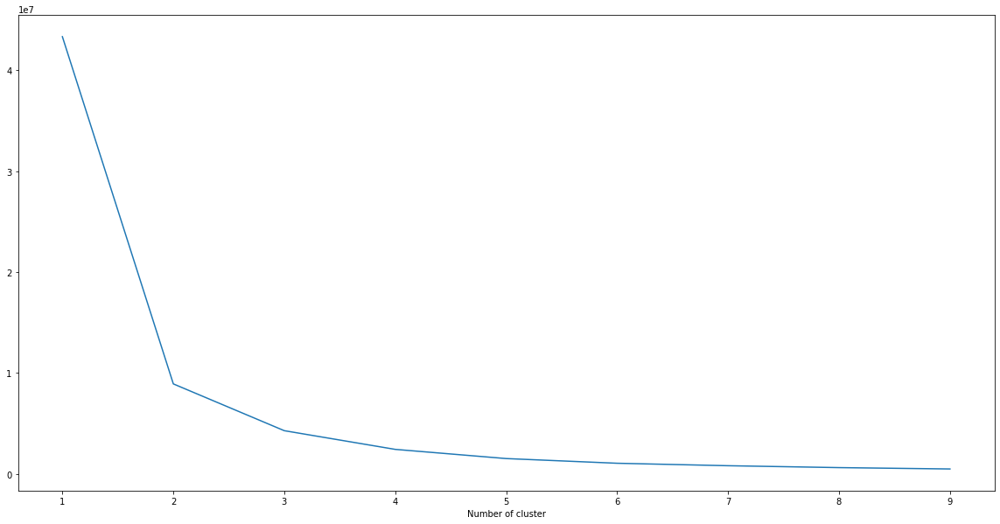

In [258]:
from sklearn.cluster import KMeans

sse={}  # error
tx_recency = tx_user[['Recency']]
for k in range(1,10):
    kmeans = KMeans(n_clusters=k,max_iter=1000).fit(tx_recency)
    tx_recency['clusters'] =kmeans.labels_ # cluster names corresponding to recency value
    sse[k] = kmeans.inertia_ # sse corresponding to clusters
plt.figure(figsize=(20,10))
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [259]:
#build 4 clusters for recency and add it to dataframe
kmeans = KMeans(n_clusters=4)
tx_user['RecencyCluster'] = kmeans.fit_predict(tx_user[['Recency']])
tx_user.head()

,customer_id,Recency,RecencyCluster
0,4355.00,43,0
1,4352.00,39,0
2,4349.00,50,0
3,4341.00,10,0
4,4339.00,218,2


In [260]:
tx_user.groupby('RecencyCluster')['Recency'].describe()

,count,mean,std,min,25%,50%,75%,max
RecencyCluster,,,,,,,,
0,2241.00,21.03,14.91,0.00,8.00,19.00,31.00,53.00
1,498.00,309.10,39.11,252.00,275.00,305.00,338.00,380.00
2,599.00,193.04,31.66,140.00,166.00,192.00,218.00,250.00
3,986.00,85.59,23.83,54.00,66.00,79.00,104.75,139.00


In [261]:
#function for ordering cluster numbers
def order_cluster(cluster_field_name, target_field_name,df,ascending):
    new_cluster_field_name = 'new_' + cluster_field_name
    df_new = df.groupby(cluster_field_name)[target_field_name].mean().reset_index()
    df_new = df_new.sort_values(by=target_field_name,ascending=ascending).reset_index(drop=True)
    df_new['index'] = df_new.index
    df_final = pd.merge(df,df_new[[cluster_field_name,'index']], on=cluster_field_name)
    df_final = df_final.drop([cluster_field_name],axis=1)
    df_final = df_final.rename(columns={"index":cluster_field_name})
    return df_final

tx_user = order_cluster('RecencyCluster', 'Recency',tx_user,False)
tx_user.head()

,customer_id,Recency,RecencyCluster
0,4355.00,43,3
1,4352.00,39,3
2,4349.00,50,3
3,4341.00,10,3
4,4331.00,12,3


In [262]:
tx_user.groupby('RecencyCluster')['Recency'].describe()

,count,mean,std,min,25%,50%,75%,max
RecencyCluster,,,,,,,,
0,498.00,309.10,39.11,252.00,275.00,305.00,338.00,380.00
1,599.00,193.04,31.66,140.00,166.00,192.00,218.00,250.00
2,986.00,85.59,23.83,54.00,66.00,79.00,104.75,139.00
3,2241.00,21.03,14.91,0.00,8.00,19.00,31.00,53.00


# Frequency 

In [263]:
#get order counts for each user and create a dataframe with it
tx_frequency = data5.groupby('customer_id').date_of_purchase.count().reset_index()
tx_frequency.columns = ['customer_id','Frequency']
tx_frequency.head() #how many orders does a customer have

,customer_id,Frequency
0,2.00,182
1,3.00,27
2,4.00,72
3,5.00,16
4,6.00,77


In [264]:
# add to this data to our dataframe

tx_user = pd.merge(tx_user,tx_frequency,on='customer_id')
tx_user.head()

,customer_id,Recency,RecencyCluster,Frequency
0,4355.00,43,3,21
1,4352.00,39,3,118
2,4349.00,50,3,98
3,4341.00,10,3,104
4,4331.00,12,3,164


In [265]:
# plot a frequency plot

plot_data = [go.Histogram(x=tx_user['Frequency'])]
plot_layout = go.Layout(title='Frequency')
fig = go.Figure(data=plot_data,layout=plot_layout)
pyoff.iplot(fig)

In [266]:
#Now we are getting maximum frequencies below 1000. But if I want to zoom and see frequencies below 1000, then what should I do?
#Let me try to plot histogram with frequencies below 1000.

#plot the histogram
plot_data = [
    go.Histogram(
        x=tx_user.query('Frequency < 1000')['Frequency']
    )
]

plot_layout = go.Layout(
        title='Frequency',
    xaxis_title = 'Frequencies'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

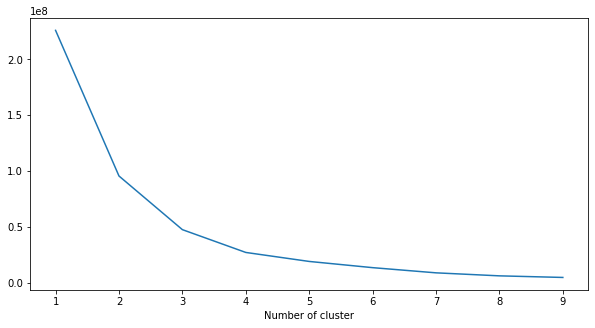

In [267]:
from sklearn.cluster import KMeans

sse={} # error
tx_recency = tx_user[['Frequency']]
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tx_recency)
    tx_recency["clusters"] = kmeans.labels_  #cluster names corresponding to recency values 
    sse[k] = kmeans.inertia_ #sse corresponding to clusters
plt.figure(figsize=(10,5))
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [268]:
# Applying k-Means
kmeans=KMeans(n_clusters=4)
tx_user['FrequencyCluster']=kmeans.fit_predict(tx_user[['Frequency']])

#order the frequency cluster
tx_user = order_cluster('FrequencyCluster', 'Frequency', tx_user, True )
tx_user.groupby('FrequencyCluster')['Frequency'].describe()

,count,mean,std,min,25%,50%,75%,max
FrequencyCluster,,,,,,,,
0,3820.00,49.12,43.99,1.00,15.00,33.50,72.00,185.00
1,476.00,322.38,130.67,186.00,220.75,281.00,382.25,799.00
2,24.00,1321.08,492.88,850.00,970.25,1127.50,1535.50,2698.00
3,4.00,5796.50,1431.85,4580.00,4966.25,5384.50,6214.75,7837.00


# 3 Revenue

In [269]:
#calculate revenue for each customer
data5['Revenue'] = data5['price']
tx_revenue = data5.groupby('customer_id').Revenue.sum().reset_index()

In [270]:
tx_revenue.head()

,customer_id,Revenue
0,2.00,553704.00
1,3.00,257404.00
2,4.00,176613.00
3,5.00,41976.00
4,6.00,166972.00


In [271]:
#merge it with our main dataframe
tx_user = pd.merge(tx_user, tx_revenue, on='customer_id')
tx_user.head()

,customer_id,Recency,RecencyCluster,Frequency,FrequencyCluster,Revenue
0,4355.00,43,3,21,0,39209.00
1,4352.00,39,3,118,0,285781.00
2,4349.00,50,3,98,0,64097.00
3,4341.00,10,3,104,0,256324.00
4,4331.00,12,3,164,0,850894.00


In [272]:
# plot a Revenue plot

plot_data = [go.Histogram(x=tx_user['Revenue'])]
plot_layout = go.Layout(title='Monetary Value')
fig = go.Figure(data=plot_data,layout=plot_layout)
pyoff.iplot(fig)

In [273]:
#plot the histogram
plot_data = [
    go.Histogram(
        x=tx_user.query('Revenue < 1000000')['Revenue']
    )
]

plot_layout = go.Layout(
        title='Monetary Value'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

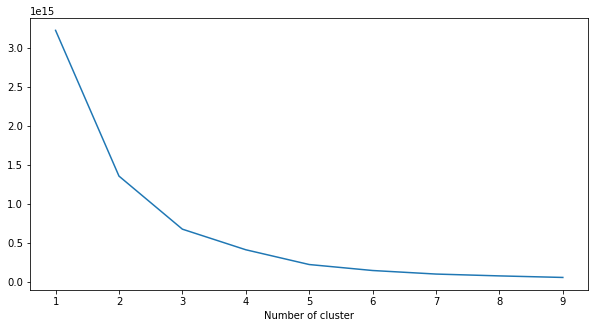

In [274]:
from sklearn.cluster import KMeans

sse={} # error
tx_recency = tx_user[['Revenue']]
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tx_recency)
    tx_recency["clusters"] = kmeans.labels_  #cluster names corresponding to recency values 
    sse[k] = kmeans.inertia_ #sse corresponding to clusters
plt.figure(figsize=(10,5))
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [275]:
#apply clustering
kmeans = KMeans(n_clusters=5)
tx_user['RevenueCluster'] = kmeans.fit_predict(tx_user[['Revenue']])

#order the cluster numbers
tx_user = order_cluster('RevenueCluster', 'Revenue',tx_user,True)

#show details of the dataframe
tx_user.groupby('RevenueCluster')['Revenue'].describe()

,count,mean,std,min,25%,50%,75%,max
RevenueCluster,,,,,,,,
0,4030.00,125457.06,125199.76,388.00,37070.50,77335.50,171322.25,593226.00
1,268.00,1067921.88,522276.35,598907.00,713839.25,854124.00,1310366.25,3340666.00
2,20.00,5799471.25,1742176.31,3537371.00,4460566.00,5452156.00,7499798.50,9375795.00
3,5.00,13642609.00,2844959.96,10654918.00,12367652.00,12657119.00,14385095.00,18148261.00
4,1.00,35536194.00,NaN,35536194.00,35536194.00,35536194.00,35536194.00,35536194.00


# overall score

In [276]:
#calculate overall score and use mean() to see details
tx_user['OverallScore'] = tx_user['RecencyCluster'] + tx_user['FrequencyCluster'] + tx_user['RevenueCluster']
tx_user.groupby('OverallScore')['Recency','Frequency','Revenue'].mean()

,Recency,Frequency,Revenue
OverallScore,,,
0,309.15,22.38,44795.68
1,193.79,32.18,68312.49
2,87.23,45.19,114362.87
3,24.77,66.93,150441.01
4,16.25,264.86,508322.34
5,11.95,371.39,1091081.58
6,9.19,852.37,3094782.56
7,8.17,1313.67,8720102.17
8,3.20,3971.80,8174167.20


In [277]:
tx_user['Segment'] = 'Low-Value'
tx_user.loc[tx_user['OverallScore']>2,'Segment'] = 'Mid-Value' 
tx_user.loc[tx_user['OverallScore']>4,'Segment'] = 'High-Value'

In [278]:
tx_user

,customer_id,Recency,RecencyCluster,Frequency,FrequencyCluster,Revenue,RevenueCluster,OverallScore,Segment
0,4355.00,43,3,21,0,39209.00,0,3,Mid-Value
1,4352.00,39,3,118,0,285781.00,0,3,Mid-Value
2,4349.00,50,3,98,0,64097.00,0,3,Mid-Value
3,4341.00,10,3,104,0,256324.00,0,3,Mid-Value
4,4313.00,1,3,134,0,333049.00,0,3,Mid-Value
...,...,...,...,...,...,...,...,...,...
4319,4234.00,2,3,322,1,10654918.00,3,7,High-Value
4320,3802.00,2,3,963,2,12367652.00,3,8,High-Value
4321,1346.00,9,3,1384,2,12657119.00,3,8,High-Value
4322,1896.00,1,3,5674,3,18148261.00,3,9,High-Value


# Actions to be taken